# Data Acquisition

### This consist of 3 parts:
1. The FourSquare Top 30 Venues to Visit in Chicago
2. For each of the Top Site get a list of up restaurants in the surrounding area
3. The Chicago Police Department Crime Data for the last Year

### Import Libraries

Before we get the data and start exploring it, let's download all the dependencies and libraries that we will need.

In [1]:
import pandas as pd # Import pandas
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import requests # Import Requests

from bs4 import BeautifulSoup # Import BeautifulSoup

In [2]:
import yaml # Yaml is used to store some of the required configurations

with open("./Data/config.yaml", "r") as f:
    cfg = yaml.load(f)
 
search_params = {
    'client_id': cfg['client_id'],
    'client_secret': cfg['client_secret'],
    'intent': 'browse',
    'limit': 50,
    'v': cfg['version']
}

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  after removing the cwd from sys.path.


## FourSquare Top 30 Venues to Visit in Chicago
To get the top venues in a city we can use the FourSquare website directly to request the top sites in Chicago and then use BeautifulSoup to scrape the data we need. Once we have this starting data the other supplemental data we need to complete this dataset can be retrieved from using the FourSquare Venue API.

In [3]:
# Use the Requests get method to request the top sites in Chicago
page = requests.get( 
    "https://foursquare.com/explore?mode=url&near=Chicago%2C%20IL%2C%20United%20States&nearGeoId=72057594042815334&q=Top%20Picks")

soup = BeautifulSoup(page.content, 'html.parser') # Convert the HTML response into a BeautifulSoup Object

top_venues = soup.find_all('div', class_='venueDetails') # Use the BeautifulSoup find_all method to extract each top site venue details.

From this HTML the following data will be extracted:

* Venue Name
* Venue Score
* Venue Category
* Venue HREF
* Venue ID (Extracted from the HREF)

### Creating Dataframe for Top Venues

The `top_venues` list, a sample of which is shown above, only contains some of the data required. In addition to the attributes extracted directly from the HTML code the following attributes are also required:
* Venue Address
* Venue Postalcode
* Venue City
* Venue Latitude
* Venue Longitude

These attributes will be obtained directly from FourSquare using the `venues` API. The process is as follows:
1. Create a new empty Pandas dataframe to hold the data for the Top Sites / Venues
1. Extract the available attributes from the HTML code
1. For each venue
    1. Contruct a URL to interagate the FourSquare Venue API for each top site
    1. Using the `venues` API and the URL request the data from FourSquare
    1. Get the properly formatted address and the latitude and longitude data from the returned JSON
    1. Write the data for each venue to the top venues dataframs

In [4]:
# The column names for the top venues dataframe
venue_columns = ['id', 
                 'score', 
                 'category', 
                 'name', 
                 'address',
                 'postalcode',
                 'city',
                 'href', 
                 'latitude', 
                 'longitude']

# Create the empty top venues dataframe
df_top_venues = pd.DataFrame(columns=venue_columns)

# For each venue in the BeautifulSoup HTML object
for venue in top_venues:
    
    # Extract the available attributes
    venue_name = venue.find(target="_blank").get_text()
    venue_score = venue.find(class_="venueScore positive").get_text()
    venue_cat = venue.find(class_="categoryName").get_text()
    venue_href = venue.find(class_="venueName").h2.a['href']
    venue_id = venue_href.split('/')[-1]

    if 'promotedTipId' in venue_id: 
        continue
        
    # Contruct the FourSquare venue API URL
    url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(
        venue_id, 
        cfg['client_id'],
        cfg['client_secret'],
        cfg['version'])
    
    # Request the venue data
    result = requests.get(url).json()
        
    # Get the properly formatted address and the latitude and longitude
    venue_address = result['response']['venue']['location']['address']
    venue_postalcode = result['response']['venue']['location']['postalCode']
    venue_city = result['response']['venue']['location']['city']
    venue_latitude = result['response']['venue']['location']['lat']
    venue_longitude = result['response']['venue']['location']['lng']
    
    # Add the venue to the top venues dataframe
    df_top_venues = df_top_venues.append({'id': venue_id,
                                          'score': venue_score,
                                          'category': venue_cat,
                                          'name': venue_name,
                                          'address': venue_address,
                                          'postalcode': venue_postalcode,
                                          'city': venue_city,
                                          'href': venue_href,
                                          'latitude': venue_latitude,
                                          'longitude': venue_longitude}, ignore_index=True)

In [5]:
df_top_venues.shape # Verify the shape of the top venues dataframe

(30, 10)

In [6]:
df_top_venues.dtypes # Verify the dtypes of the top venues dataframe

id             object
score          object
category       object
name           object
address        object
postalcode     object
city           object
href           object
latitude      float64
longitude     float64
dtype: object

In [7]:
df_top_venues['score'] = pd.to_numeric(df_top_venues['score'], errors='coerce').fillna(0) # The score type needs to be converted to float

df_top_venues.score.describe() # Describe the score to see if there is nuch variance in the values

count    30.000000
mean      9.436667
std       0.071840
min       9.300000
25%       9.400000
50%       9.400000
75%       9.500000
max       9.600000
Name: score, dtype: float64

In [8]:
df_top_venues.head() # Review the head of the dataframe to make sure it looks as expected

,id,score,category,name,address,postalcode,city,href,latitude,longitude
0,42b75880f964a52090251fe3,9.6,Park,Millennium Park,201 E Randolph St,60601,Chicago,/v/millennium-park/42b75880f964a52090251fe3,41.883112,-87.623851
1,49e9ef74f964a52011661fe3,9.5,Art Museum,The Art Institute of Chicago,111 S Michigan Ave,60603,Chicago,/v/the-art-institute-of-chicago/49e9ef74f964a5...,41.879610,-87.623552
2,4c47533649fa9521cb1f5e62,9.5,Park,Grant Park,337 E Randolph Dr,60601,Chicago,/v/grant-park/4c47533649fa9521cb1f5e62,41.876626,-87.619263
3,4b9d15c5f964a520478e36e3,9.5,Waterfront,Chicago Riverwalk,Chicago River,60601,Chicago,/v/chicago-riverwalk/4b9d15c5f964a520478e36e3,41.887280,-87.627217
4,4adfca6df964a520777d21e3,9.5,Concert Hall,Symphony Center (Chicago Symphony Orchestra),220 S Michigan Ave,60604,Chicago,/v/symphony-center-chicago-symphony-orchestra/...,41.879275,-87.624680


In [9]:
df_top_venues.to_pickle('./Pickles/top_venues.pkl') # Finally write the dataframe to a pickle file for restoring later

## FourSquare Restaurent Recommendations Data

Using the the list of all venue id values in the Top Sites DataFrame and the FourSquare categoryID that represents all food venues, we now search for restaurants within a 500 meter radius.

The requests returns a JSON object which can then be queried for the restaurant details required.From this JSON the following attributes are extraced and added to the Dataframe:

* Restaurant ID
* Restaurant Category Name
* Restaurant Category ID
* Restaurant Nest_name
* Restaurant Address
* Restaurant Postalcode
* Restaurant City
* Restaurant Latitude
* Restaurant Longitude
* Venue Name
* Venue Latitude
* Venue Longitude

The only piece of data that is missing is the Score or Rating of the Restaurant. To get this we need to make another FourSquare API query using the id of the Restaurant.

Using just the data in this DataFrame we will be able to generate maps displaying the chosen Top List Venue and the best scored surrounding restaurants.

In [10]:
#The column names for the restaurants dataframe
restaurants_columns = ['id',
                       'score', 
                       'category', 
                       'categoryID', 
                       'name', 
                       'address',
                       'postalcode',
                       'city',
                       'latitude',
                       'longitude', 
                       'venue_name', 
                       'venue_latitude',
                       'venue_longitude']

# Create the empty top venues dataframe
df_restaurant = pd.DataFrame(columns=restaurants_columns)

# Create a list of all the top venue latitude and longitude
top_venue_lats = df_top_venues['latitude'].values
top_venue_lngs = df_top_venues['longitude'].values

# Create a list of all the top venue names
top_venue_names = df_top_venues['name'].values

# Iterate over each of the top venues
# The venue name, latitude and longitude are passed to the loop
for ven_name, ven_lat, ven_long in zip(top_venue_names, top_venue_lats, top_venue_lngs):
    
    # Configure additional Search parameters
    # This is the FourSquare Category Id for all food venues
    categoryId = '4d4b7105d754a06374d81259'
    radius = 500
    limit = 50
    
    # Contruct the FourSquare search API URL
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&categoryId={}&radius={}&limit={}'.format(
        cfg['client_id'],
        cfg['client_secret'],
        ven_lat,
        ven_long,
        cfg['version'],
        categoryId,
        radius,
        limit)
    
    # Make the search request
    results = requests.get(url).json()
    
    # Want a good selection of Restaurents
    # If less than 10 are returned ignore
    if len(results['response']['venues']) < 10:
        continue
        
    # Populate the new dataframe with the list of restaurants
    # Get the values for each Restaurant from the JSON
    for restaurant in results['response']['venues']:
 
        # Sometimes the Venue JSON is missing data. If so ignore and continue
        try:
            # Get location details
            rest_id = restaurant['id']
            rest_category = restaurant['categories'][0]['pluralName']
            rest_categoryID = restaurant['categories'][0]['id']
            rest_name = restaurant['name']
            rest_address = restaurant['location']['address']
            rest_postalcode = restaurant['location']['postalCode']
            rest_city = restaurant['location']['city']
            rest_latitude = restaurant['location']['lat']
            rest_longitude = restaurant['location']['lng']
            
            # Contruct the FourSquare venue API URL to get the venues rating / score
            rest_url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(
                rest_id, 
                cfg['client_id'],
                cfg['client_secret'],
                cfg['version'])

            # Get the restaurant score and href
            result = requests.get(rest_url).json()
            rest_score = result['response']['venue']['rating']
            
            # Add the restaurant details to the dataframe
            df_restaurant = df_restaurant.append({'id': rest_id,
                                                  'score': rest_score,
                                                  'category': rest_category,
                                                  'categoryID': rest_categoryID,
                                                  'name': rest_name,
                                                  'address': rest_address,
                                                  'postalcode': rest_postalcode,
                                                  'city': rest_city,
                                                  'latitude': rest_latitude,
                                                  'longitude': rest_longitude,
                                                  'venue_name': ven_name,
                                                  'venue_latitude': ven_lat,
                                                  'venue_longitude': ven_long}, ignore_index=True)
            
        # If there are any issue with a restaurant ignore and continue
        except:
            continue
            

In [11]:
df_restaurant.shape # Verify the shape of the restaurants dataframe

(111, 13)

In [12]:
df_restaurant.dtypes # Verify the dtypes of the restaurants dataframe

id                  object
score              float64
category            object
categoryID          object
name                object
address             object
postalcode          object
city                object
latitude           float64
longitude          float64
venue_name          object
venue_latitude     float64
venue_longitude    float64
dtype: object

In [13]:
df_restaurant.head() # Review the head of the dataframe to make sure it looks as expected

,id,score,category,categoryID,name,address,postalcode,city,latitude,longitude,venue_name,venue_latitude,venue_longitude
0,551192b1498e8695352d33e6,8.3,American Restaurants,4bf58dd8d48988d14e941735,Remington's,20 N Michigan Ave,60602,Chicago,41.882628,-87.624608,Millennium Park,41.883112,-87.623851
1,4e879cdc93adfd051d6d609e,9.0,Breakfast Spots,4bf58dd8d48988d143941735,Wildberry Pancakes & Cafe,130 E Randolph St,60601,Chicago,41.884412,-87.623047,Millennium Park,41.883112,-87.623851
2,4ed3dd7e93ad987b5112d29f,8.2,Bakeries,4bf58dd8d48988d16a941735,Panera Bread,2 N Michigan Ave,60602,Chicago,41.882228,-87.624703,Millennium Park,41.883112,-87.623851
3,4e73881c922e0a374024c7b8,7.7,Coffee Shops,4bf58dd8d48988d1e0931735,Starbucks,8 N Michigan Ave,60602,Chicago,41.882478,-87.624701,Millennium Park,41.883112,-87.623851
4,4e56e50352b1d8d4e311da9e,8.7,Bakeries,4bf58dd8d48988d16a941735,Toni Patisserie & Café,65 E Washington St,60602,Chicago,41.883237,-87.625362,Millennium Park,41.883112,-87.623851


In [14]:
df_restaurant.score.describe() # Describe the score to see if there is nuch variance in the values

count    111.000000
mean       7.942342
std        0.775951
min        5.800000
25%        7.450000
50%        8.100000
75%        8.600000
max        9.200000
Name: score, dtype: float64

In [15]:
df_restaurant.venue_name.nunique() # How many of the top 30 sites / venues had > 10 restaurants nearby

5

In [16]:
df_restaurant.category.nunique() # How many unique restaurant categories are there

31

In [17]:
df_restaurant.name.nunique() # How many unique restaurants are there

59

In [18]:
df_restaurant.groupby('category')['name'].count().sort_values(ascending=False)[:10] # What arethe top 10 most frequently occuring restaurant types

category
Coffee Shops                  27
American Restaurants           8
Bakeries                       6
Cafés                          6
Donut Shops                    5
Pubs                           5
Pizza Places                   5
Sandwich Places                4
New American Restaurants       4
Middle Eastern Restaurants     3
Name: name, dtype: int64

In [19]:
df_restaurant.groupby('category')['score'].mean().sort_values(ascending=False)[:10] # Which restaurants have to highest average score

category
Breakfast Spots                   9.000000
Gastropubs                        8.933333
Middle Eastern Restaurants        8.700000
Vegetarian / Vegan Restaurants    8.600000
Snack Places                      8.600000
Bakeries                          8.500000
Pizza Places                      8.480000
Steakhouses                       8.400000
Burger Joints                     8.400000
Tapas Restaurants                 8.300000
Name: score, dtype: float64

In [20]:
df_restaurant.to_pickle('./Pickles/restaurants.pkl') # Finally write the dataframe to a pickle file for restoring later

## Chicago Crime DataSet

This dataset reflects reported incidents of crime (with the exception of murders where data exists for each victim) that occurred in the City of Chicago in the last year, minus the most recent seven days. Data is extracted from the Chicago Police Department's CLEAR (Citizen Law Enforcement Analysis and Reporting) system. In order to protect the privacy of crime victims, addresses are shown at the block level only and specific locations are not identified.

| Column Name   | Type          | Description                                            | 
| :------------ | :------------ | :----------------------------------------------------- | 
| Case Number    | Plain Text    | The Chicago Police Department RD Number (Records Division Number), which is unique to the incident. | 
| Date | Date & Time   | Date when the incident occurred. this is sometimes a best estimate. |
| Block	        | Plain Text    | The partially redacted address where the incident occurred, placing it on the same block as the actual address. |
| IUCR	        | Plain Text    | The Illinois Unifrom Crime Reporting code. This is directly linked to the Primary Type and Description. See the list of IUCR codes at https://data.cityofchicago.org/d/c7ck-438e. |
| Primary Type   | Plain Text    | The primary description of the IUCR code. |
| Description	| Plain Text    | The secondary description of the IUCR code, a subcategory of the primary description. |
| Location Description | Plain Text | Description of the location where the incident occurred. |
| Arrest        | Plain Text    | Indicates whether an arrest was made. |
| Domestic      | Plain Text    | Indicates whether the incident was domestic-related as defined by the Illinois Domestic Violence Act. |
| Beat          | Plain Text    | Indicates the beat where the incident occurred. A beat is the smallest police geographic area – each beat has a dedicated police beat car. Three to five beats make up a police sector, and three sectors make up a police district. The Chicago Police Department has 22 police districts. See the beats at https://data.cityofchicago.org/d/aerh-rz74. |
| Ward	        | Number        | The ward (City Council district) where the incident occurred. See the wards at https://data.cityofchicago.org/d/sp34-6z76. |
| FBI Code        | Plain Text    | Indicates the crime classification as outlined in the FBI's National Incident-Based Reporting System (NIBRS). See the Chicago Police Department listing of these classifications at http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html. |
| X Coordinate	| Plain Text    | The x coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block. |
| Y Coordinate	| Plain Text    | The y coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block. |
| Latitude	    | Number        | The latitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block. |
| Longitude	    | Number        | The longitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block. |
| Location	    | Location      | The location where the incident occurred in a format that allows for creation of maps and other geographic operations on this data portal. This location is shifted from the actual location for partial redaction but falls on the same block. |
	


### Import the 2019 DataSet

The full dataset, 2001 to 2019 contains over 7.03M rows. This makes processing the dataset difficult and time consuming. Only the 2019 data, 242720 records, will be used. In addition, the following clean-up steps are required:

Not all of the columns are required. The following columns are removed:
* IUCR
* ARREST
* DOMESTIC
* BEAT
* WARD
* FBI CD
* X COORDINATE
* Y COORDINATE
* LOCATION

In [22]:
# These are the columns that we want to keep. Others will not be imported.
crime_keep_columns = ['Case Number',
                      'Date',
                      'Block', 
                      'Primary Type',
                      'Ward',
                      'Latitude',
                      'Longitude']

In [23]:
# Download csv
#!wget -O './Data/crimes.csv' https://data.cityofchicago.org/api/views/w98m-zvie/rows.csv?accessType=DOWNLOAD

In [24]:
df = pd.read_csv('./Data/crimes.csv',
                 usecols=crime_keep_columns) # Read cvs download into datafram

In [25]:
df.shape # Check the shape of the dataframe

(244701, 7)

In [26]:
df.head() # Review the head of the dataframe to make sure it looks as expected

,Case Number,Date,Block,Primary Type,Ward,Latitude,Longitude
0,JC549381,12/11/2019 03:11:00 PM,101XX S LOWE AVE,THEFT,34.0,41.710046,-87.639273
1,JC549064,12/06/2019 10:00:00 AM,048XX W HURON ST,THEFT,37.0,41.893150,-87.747057
2,JC543931,12/12/2019 09:49:00 AM,013XX N PAULINA ST,THEFT,1.0,41.906276,-87.670012
3,JC544198,12/12/2019 01:42:00 PM,045XX S WESTERN AVE,THEFT,15.0,41.810768,-87.684508
4,JC544389,12/12/2019 01:00:00 PM,071XX S CLAREMONT AVE,MOTOR VEHICLE THEFT,18.0,41.764136,-87.681903


---
### Clean up the data and prepare

Now that the data has been imported it needs to be cleaned.

* Clean up the column names:
    1. Strip leading & trailing whitespace
    1. Replace multiple spaces with a single space
    1. Remove # characters
    1. Replace spaces with _
    2. Convert to lowercase
* Change the date of occurance field to a date / time object
* Add new columns for:
    1. Hour
    1. Day
    1. Month
    1. Year
    1. etc.
* Split Block into zip_code and street
* Verify that all rows have valid data

In [27]:
df.columns = df.columns.str.strip() # Strip leading & trailing whitespace

df.columns = df.columns.str.replace('\s{2,}', ' ') # Replace multiple spaces with a single space

df.columns = df.columns.str.replace('#', '') # Replace # with blank

df.columns = df.columns.str.replace(' ', '_') # Replace spaces with _

df.columns = df.columns.str.lower() # Convert to lowercase


In [28]:
df.dtypes # Verify that all datatype are as expected

case_number      object
date             object
block            object
primary_type     object
ward            float64
latitude        float64
longitude       float64
dtype: object

In [29]:
df['date'] = pd.to_datetime(df['date'], format='%m/%d/%Y %I:%M:%S %p') #Change the date field to a date / time object

Now that the date date of the crime is a real date time object let's add new columns for the hour, day, month and year of the crime etc:
1. Hour
1. Day Name
1. Day of week (Tuesday is the first day)
1. Month Name
1. Month Number
1. Year
1. Year and Month

In [30]:
# Add new columns to the dataframe to allow hourly, daily & monthly analysis
df['hour'] = df['date'].dt.hour
df['day_name'] = df['date'].dt.day_name()
df['day'] = df['date'].dt.dayofweek + 1
df['month_name'] = df['date'].dt.month_name()
df['month'] = df['date'].dt.month
df['year'] = df['date'].dt.year
df['year_month'] = df['date'].dt.to_period('M')

The Block attribute can be split into zip_code and street

In [31]:
# Add the zip and street attributes
df['zip'] = df.block.str.split(' ').str[0]
df['street'] = df.block.str.split(' ').str[1:].apply(', '.join)

Verify that all rows have valid data

In [32]:
df.isna().sum() # Verify that all rows have valid data

case_number        0
date               0
block              0
primary_type       0
ward              14
latitude        1263
longitude       1263
hour               0
day_name           0
day                0
month_name         0
month              0
year               0
year_month         0
zip                0
street             0
dtype: int64

In [33]:
# Drop rows with missing values 
df.dropna(inplace=True)

In [34]:
# Reindex
df.reset_index(inplace=True)

In [35]:
# Have a final look at the crime dataframe
df.head()

,index,case_number,date,block,primary_type,ward,latitude,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
0,0,JC549381,2019-12-11 15:11:00,101XX S LOWE AVE,THEFT,34.0,41.710046,-87.639273,15,Wednesday,3,December,12,2019,2019-12,101XX,"S, LOWE, AVE"
1,1,JC549064,2019-12-06 10:00:00,048XX W HURON ST,THEFT,37.0,41.893150,-87.747057,10,Friday,5,December,12,2019,2019-12,048XX,"W, HURON, ST"
2,2,JC543931,2019-12-12 09:49:00,013XX N PAULINA ST,THEFT,1.0,41.906276,-87.670012,9,Thursday,4,December,12,2019,2019-12,013XX,"N, PAULINA, ST"
3,3,JC544198,2019-12-12 13:42:00,045XX S WESTERN AVE,THEFT,15.0,41.810768,-87.684508,13,Thursday,4,December,12,2019,2019-12,045XX,"S, WESTERN, AVE"
4,4,JC544389,2019-12-12 13:00:00,071XX S CLAREMONT AVE,MOTOR VEHICLE THEFT,18.0,41.764136,-87.681903,13,Thursday,4,December,12,2019,2019-12,071XX,"S, CLAREMONT, AVE"


In [36]:
df.shape

(243424, 17)

In [37]:
# Finally write the dataframe to a pickle file for restoring later
df.to_pickle('./Pickles/crimes.pkl')

The data is now ready for visualisation.

# Visualising The Chicago Crime Data

To get a better understanding of the Chicago Crime Dataset it will be helpful to visualise the data.

In [38]:
import pandas as pd # Import Pandas

# Use the inline backend to generate the plots within the browser
#%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 14}
mpl.rc('font', **font)

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

In [39]:
# Import the Pickle of the DataFrame
df_crimes = pd.read_pickle('./Pickles/crimes.pkl')

### Number of Crimes per month

Text(0.0, 1.0, 'Number of Cases Per Month')

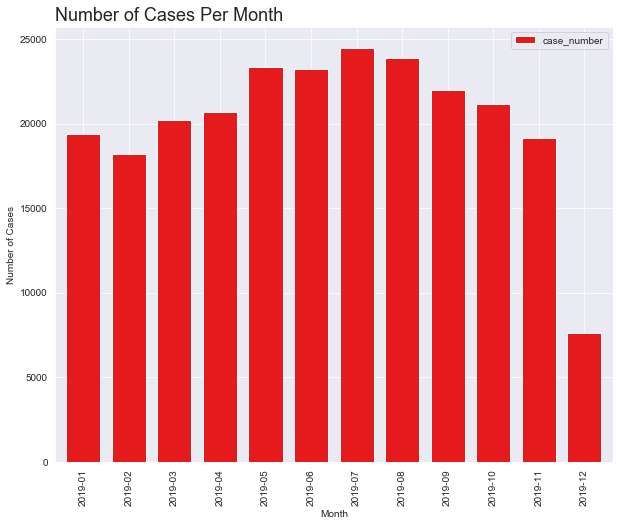

In [40]:
# Group the Crimes per month and produce a bar chart
df_crimes.groupby('year_month').count().plot(y = 'case_number', 
                                             kind='bar',
                                             figsize=(10,8),
                                             width=0.75,
                                             colormap='Set1')

plt.xlabel('Month')
plt.ylabel('Number of Cases')
plt.title('Number of Cases Per Month', loc='left', fontsize=18)

Unsuprisingly there little obvious variation in the number of crimes committed per month other than an apparent increase in july.

### Number of crimes occuring on each day

Text(0.0, 1.0, 'Number of Cases Per Day of Week')

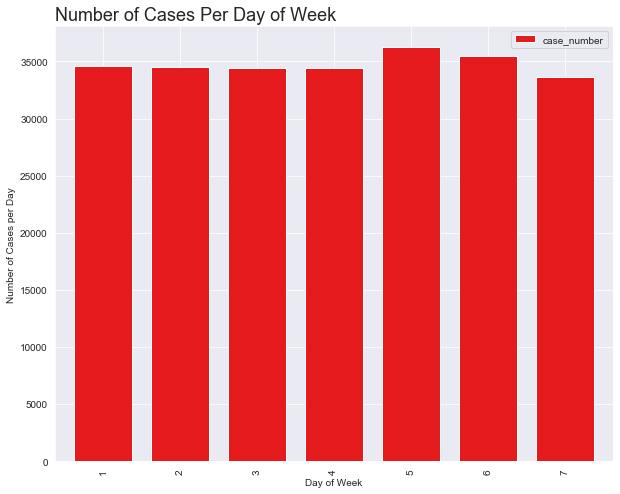

In [41]:
# Group the Crimes per day and produce a bar chart
df_crimes.groupby('day').count().plot(y = 'case_number',
                                      kind='bar',
                                      figsize=(10,8),
                                      width=0.75,
                                      colormap='Set1')
plt.xlabel('Day of Week')
plt.ylabel('Number of Cases per Day')
plt.title('Number of Cases Per Day of Week', loc='left', fontsize=18)

No significant change throught the week is observed

### Number of crimes occuring in each hour

Text(0.0, 1.0, 'Number of Cases Per Hour]')

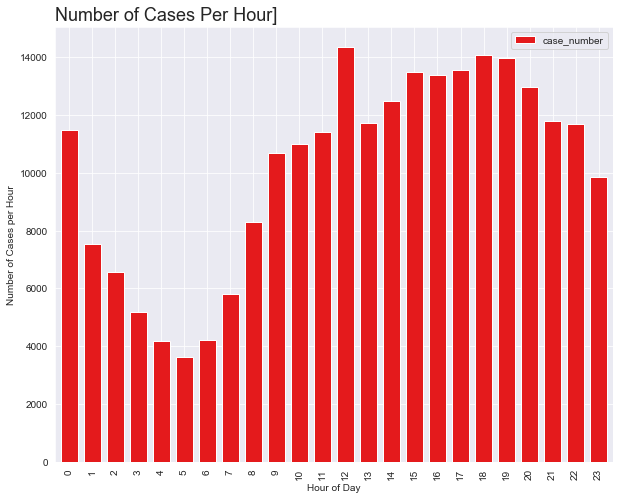

In [42]:
# Group the Crimes per hour and produce a bar chart
df_crimes.groupby('hour').count().plot(y = 'case_number',
                                       kind='bar',
                                       figsize=(10,8),
                                       width=0.75,
                                       colormap='Set1')

plt.xlabel('Hour of Day')
plt.ylabel('Number of Cases per Hour')
plt.title('Number of Cases Per Hour]', loc='left', fontsize=18)

There is an expected fall-off in reported crime rates after midnight before elevating again after eight in the morning. There appears to be a spike around midday.

### Now let's look at the Crime Categories.

In [43]:
df_crimes.primary_type.nunique() # Number of unique Crime categories bases on the Primary Description

31

In [44]:
# What are the 10 most commonly occuring crimes 

df_crimes[['primary_type', 'case_number']].groupby(['primary_type'], as_index=False).count().sort_values('case_number', ascending=False).head(10)

,primary_type,case_number
29,THEFT,58046
2,BATTERY,46989
6,CRIMINAL DAMAGE,25339
1,ASSAULT,19674
8,DECEPTIVE PRACTICE,16306
22,OTHER OFFENSE,15769
17,NARCOTICS,13282
3,BURGLARY,9046
16,MOTOR VEHICLE THEFT,8453
26,ROBBERY,7515


In [45]:
# Create a list of the 10 most commonly occuring crimes

top_ten_crimes = df_crimes[['primary_type', 'case_number']].groupby(['primary_type']).count().sort_values('case_number', ascending=False)[:10].axes[0].tolist()

In order to get a better understanding of the top ten crimes lets first create smaller dataframe the only contains these top crimes. Next we'll visualise these crimes using area charts.

Text(0.0, 1.0, 'Top 10 Cases Per Month')

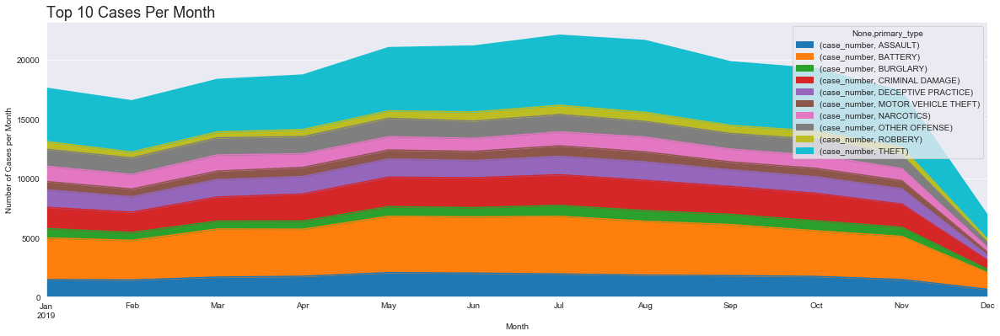

In [46]:
# Create a new data frame with just the top 10 crimes

df_top10_crimes = df_crimes[df_crimes['primary_type'].isin(top_ten_crimes)].copy()

# Create a pivot area chart of the crimes per month

df_top10_crimes[['case_number', 'primary_type', 'year_month']].pivot_table(
    index='year_month', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(20, 6),
                          colormap='tab10')

plt.xlabel('Month')
plt.ylabel('Number of Cases per Month')
plt.title('Top 10 Cases Per Month', loc='left', fontsize=18)

It would appear that crimes peak in the Summer months and then fall off in Winter. 

Now look per day.

Text(0.0, 1.0, 'Top 10 Cases Per Day')

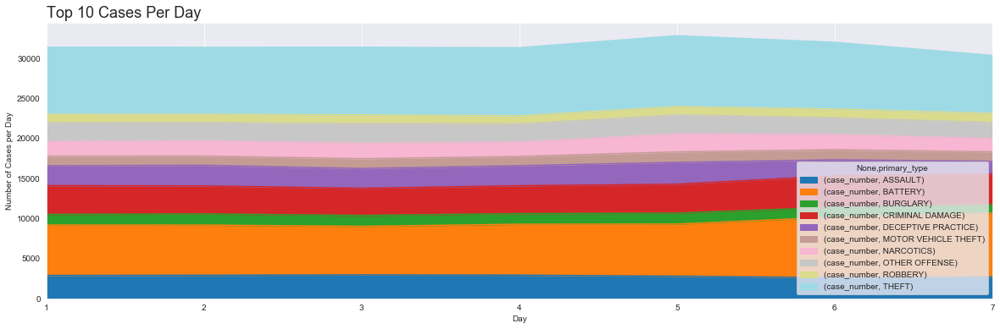

In [47]:
# Create a pivot area chart of the crimes per day

df_top10_crimes[['case_number', 'primary_type', 'day']].pivot_table(
    index='day', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(20, 6),
                          colormap='tab20')

plt.xlabel('Day')
plt.ylabel('Number of Cases per Day')
plt.title('Top 10 Cases Per Day', loc='left', fontsize=18)

This chart suggests that Saturday, Sunday & Monday (Monday is Day 1) have more crime but that this increase is driven by the crime of Theft.

 Finally lets look per hour.

Text(0.0, 1.0, 'Top 10 Cases Per Hour')

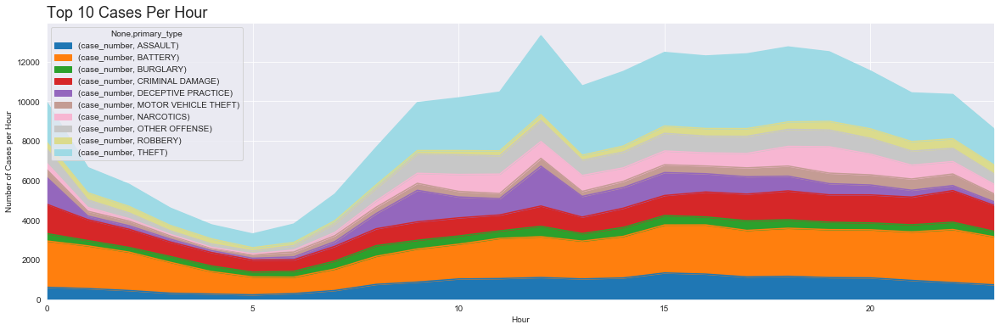

In [48]:
# Create a pivot area chart of the crimes per hour

df_top10_crimes[['case_number', 'primary_type', 'hour']].pivot_table(
    index='hour', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(20, 6),
                          colormap='tab20')

plt.xlabel('Hour')
plt.ylabel('Number of Cases per Hour')
plt.title('Top 10 Cases Per Hour', loc='left', fontsize=18)

It would appear that 5:00 am in the morning is the safest time in Chicago whilst 12:00 pm in the afternoon is the most dangerous.

### Create a folium map with a different colour per crime

Colour each of the top 10 crimes with a different and plot on a Folium map.

In [49]:
# Create a list of 10 colours. 

colors10 = [
    'red',
    'blue',
    'gray',
    'orange',
    'beige',
    'green',
    'purple',
    'pink',
    'cadetblue',
    'black'
]

# Create a dictionary of colours to map to the crimes

dict_colours10 = dict(zip(top_ten_crimes, colors10))

In [50]:
#To display maps with marker
def display_map(m):
    from IPython.display import HTML

    
    with open(m) as f:
        html = f.read()

    iframe = '<iframe srcdoc="{srcdoc}" style="width: 100%; height: 750px; border: none"></iframe>'
    srcdoc = html.replace('"', '&quot;')
    return HTML(iframe.format(srcdoc=srcdoc))

The entire `df_top10_crimes` DataFrame contains too many point to disply effeciently using Folium. To combat this we will just use the data from November 2019.

In [51]:
# Add the colours colums to the df_top_crimes DataFrame

df_top10_crimes['colour'] = df_top10_crimes.primary_type.map(dict_colours10)

# Filter the top 10 crimes dataframe to extract November only

df_top10_crimes_november = df_top10_crimes[df_top10_crimes.month_name == 'November']

# Pickle the DataFrame to Separate the Folium Maps into a Separate Notepad

df_top10_crimes_november.to_pickle('./Pickles/top10crimes_november.pkl')

#### Marker Map of the Top 10 Crimes in the month of November 2019

In [52]:
# Define Chicago's geolocation coordinates

chicago_latitude = 41.85  
chicago_longitude = -87.75

In [147]:
# Define the world map centered around Chicago with a higher zoom level

chicago_map = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map

chicago_map

# Instantiate a feature group for the incidents in the dataframe

incidents = folium.map.FeatureGroup()

# loop through the November crimes and add each to the incidents feature group

for lat, lng, col in zip(df_top10_crimes_november.latitude, 
                         df_top10_crimes_november.longitude, 
                         df_top10_crimes_november.colour):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=1, # define how big you want the circle markers to be
            color=col,
            fill=True,
            fill_color=col,
            fill_opacity=0.6
        )
    )

# add incidents to map

chicago_map.add_child(incidents)
chicago_map.save(outfile="./Maps/MarkerMaps.html")
map_path = "./Maps/MarkerMaps.html"
display_map(map_path)

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\display.py:694: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In the map above the crimes data for a single month, November, was super-imposed over a map of Chicago to visualise the distribution of that data. The higher frequency of the top two crimes can be easily seen. Red for Theft and Blue for Battery.

Next the same data was added to a Cluster Map.

In [54]:
mc = MarkerCluster()

# Define the world map centered around Chicago with a higher zoom level
chicago_cluster = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map
chicago_cluster

#creating a Marker for each point in df_sample. Each point will get a popup with their zip
for row in df_top10_crimes_november.itertuples():
    mc.add_child(folium.Marker(
        location=[row.latitude,  row.longitude],
                 popup=row.primary_type))
 
chicago_cluster.add_child(mc)
chicago_cluster.save(outfile="./Maps/ClusterMaps.html")
m = "./Maps/ClusterMaps.html"
display_map(m)

Several obvious clusters of crime locations were visible, particularly in the center of Chicago.

Finally a heat map of the November crimes was created.

In [55]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11) 

# List comprehension to make out list of lists
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_top10_crimes_november.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

This reinforces the cluster chart where it can clearly be seen that the center of Chicago and the area around Oak Park have a high crime rate occurrence. It will be interesting to see later if there is a high probability of crime in these areas if one of the top listed venues are located in these areas.

# Inferential Statistics

Inferential statistics allows us to provide insight on a given topic. There are many types of statistical tests that allows one to make inferences. Some of the common statistical tests are:

* Correlations
* Chi-square test
* Independent t-test (a.k.a Student’s t-test)
* Paired sample t-test
* Welch’s t-test
* Wilcoxon signed-rank test
* Linear regression
* Logistic regression
* One-way Analysis of Variance (ANOVA)
* Two-way/N-way ANOVA

In this section we will investigate if there are any obvious inferential statisticical methods that can help us when modelling the data.

## Import required Libraries

We start, as normal, by importing required libaries.

In [56]:
import pandas as pd # Import Pandas

# Use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 14}
mpl.rc('font', **font)

## Import Dataframes from Pickle files

We load in the exported pickle files of the dataframes created in the Data Acquition Section.

In [57]:
# Import the Pickle of the Crimes DataFrame

df_crimes = pd.read_pickle('./Pickles/crimes.pkl')
df_crimes.drop('index', inplace=True, axis=1)

# Import the Pickle of the Top Venues DataFrame

df_topvnues = pd.read_pickle('./Pickles/top_venues.pkl')

# Import the Pickle of the Restaurants DataFrame

df_rest = pd.read_pickle('./Pickles/restaurants.pkl')

In [58]:
df_crimes.head()

,case_number,date,block,primary_type,ward,latitude,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
0,JC549381,2019-12-11 15:11:00,101XX S LOWE AVE,THEFT,34.0,41.710046,-87.639273,15,Wednesday,3,December,12,2019,2019-12,101XX,"S, LOWE, AVE"
1,JC549064,2019-12-06 10:00:00,048XX W HURON ST,THEFT,37.0,41.893150,-87.747057,10,Friday,5,December,12,2019,2019-12,048XX,"W, HURON, ST"
2,JC543931,2019-12-12 09:49:00,013XX N PAULINA ST,THEFT,1.0,41.906276,-87.670012,9,Thursday,4,December,12,2019,2019-12,013XX,"N, PAULINA, ST"
3,JC544198,2019-12-12 13:42:00,045XX S WESTERN AVE,THEFT,15.0,41.810768,-87.684508,13,Thursday,4,December,12,2019,2019-12,045XX,"S, WESTERN, AVE"
4,JC544389,2019-12-12 13:00:00,071XX S CLAREMONT AVE,MOTOR VEHICLE THEFT,18.0,41.764136,-87.681903,13,Thursday,4,December,12,2019,2019-12,071XX,"S, CLAREMONT, AVE"


In [59]:
df_crimeward_crosstab = pd.crosstab(df_crimes.primary_type, df_crimes.ward)

---

In [60]:
df_topvnues.head()

,id,score,category,name,address,postalcode,city,href,latitude,longitude
0,42b75880f964a52090251fe3,9.6,Park,Millennium Park,201 E Randolph St,60601,Chicago,/v/millennium-park/42b75880f964a52090251fe3,41.883112,-87.623851
1,49e9ef74f964a52011661fe3,9.5,Art Museum,The Art Institute of Chicago,111 S Michigan Ave,60603,Chicago,/v/the-art-institute-of-chicago/49e9ef74f964a5...,41.879610,-87.623552
2,4c47533649fa9521cb1f5e62,9.5,Park,Grant Park,337 E Randolph Dr,60601,Chicago,/v/grant-park/4c47533649fa9521cb1f5e62,41.876626,-87.619263
3,4b9d15c5f964a520478e36e3,9.5,Waterfront,Chicago Riverwalk,Chicago River,60601,Chicago,/v/chicago-riverwalk/4b9d15c5f964a520478e36e3,41.887280,-87.627217
4,4adfca6df964a520777d21e3,9.5,Concert Hall,Symphony Center (Chicago Symphony Orchestra),220 S Michigan Ave,60604,Chicago,/v/symphony-center-chicago-symphony-orchestra/...,41.879275,-87.624680


Text(0.0, 1.0, 'Scatter Plot of Top Venues Latitude and Score')

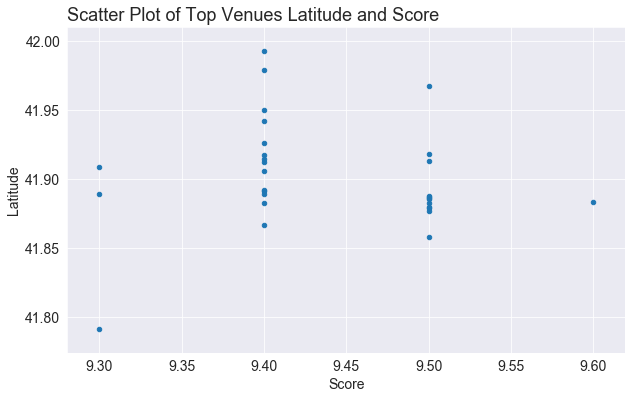

In [61]:
df_topvnues.plot.scatter('score', 'latitude', figsize=(10,6))

plt.xlabel('Score')
plt.ylabel('Latitude')
plt.title('Scatter Plot of Top Venues Latitude and Score', loc='left', fontsize=18)

Text(0.0, 1.0, 'Scatter Plot of Top Venues Longitude and Score')

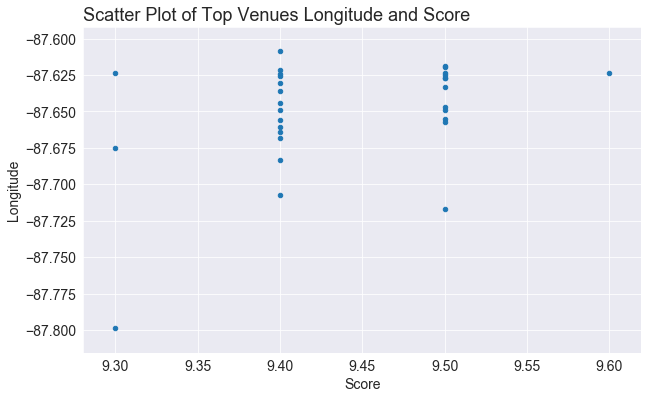

In [62]:
df_topvnues.plot.scatter('score', 'longitude', figsize=(10,6))

plt.xlabel('Score')
plt.ylabel('Longitude')
plt.title('Scatter Plot of Top Venues Longitude and Score', loc='left', fontsize=18)

---

In [63]:
df_rest.head()

,id,score,category,categoryID,name,address,postalcode,city,latitude,longitude,venue_name,venue_latitude,venue_longitude
0,551192b1498e8695352d33e6,8.3,American Restaurants,4bf58dd8d48988d14e941735,Remington's,20 N Michigan Ave,60602,Chicago,41.882628,-87.624608,Millennium Park,41.883112,-87.623851
1,4e879cdc93adfd051d6d609e,9.0,Breakfast Spots,4bf58dd8d48988d143941735,Wildberry Pancakes & Cafe,130 E Randolph St,60601,Chicago,41.884412,-87.623047,Millennium Park,41.883112,-87.623851
2,4ed3dd7e93ad987b5112d29f,8.2,Bakeries,4bf58dd8d48988d16a941735,Panera Bread,2 N Michigan Ave,60602,Chicago,41.882228,-87.624703,Millennium Park,41.883112,-87.623851
3,4e73881c922e0a374024c7b8,7.7,Coffee Shops,4bf58dd8d48988d1e0931735,Starbucks,8 N Michigan Ave,60602,Chicago,41.882478,-87.624701,Millennium Park,41.883112,-87.623851
4,4e56e50352b1d8d4e311da9e,8.7,Bakeries,4bf58dd8d48988d16a941735,Toni Patisserie & Café,65 E Washington St,60602,Chicago,41.883237,-87.625362,Millennium Park,41.883112,-87.623851


Text(0.0, 1.0, 'Scatter Plot of Restaurants Latitude and Score')

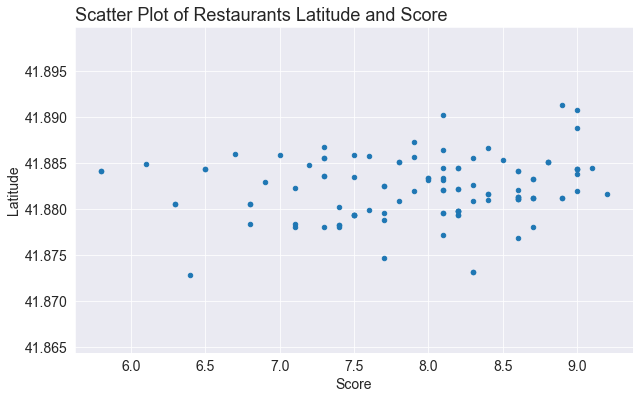

In [64]:
df_rest.plot.scatter('score', 'latitude', figsize=(10,6))

plt.xlabel('Score')
plt.ylabel('Latitude')
plt.title('Scatter Plot of Restaurants Latitude and Score', loc='left', fontsize=18)

Text(0.0, 1.0, 'Scatter Plot of Restaurants Longitude and Score')

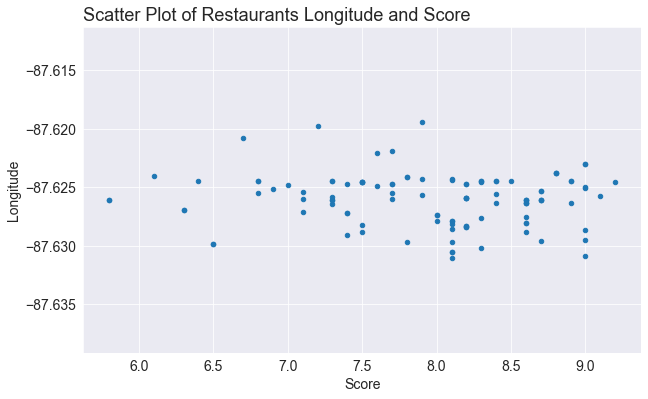

In [65]:
df_rest.plot.scatter('score', 'longitude', figsize=(10,6))

plt.xlabel('Score')
plt.ylabel('Longitude')
plt.title('Scatter Plot of Restaurants Longitude and Score', loc='left', fontsize=18)

# Model Creation and Evaluation

In this section multiple models will be created and evaluated before a final model is chosen and evaluated.

## Import Libraries

As always, we start by importing the required libraries

In [66]:
# Import Pandas
import pandas as pd

# Import Numpy
import numpy as np

# All the SciKit Learn Libraries Required
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import KFold, cross_val_score

# Decision Tree
from datetime import datetime
from sklearn.tree import DecisionTreeClassifier

# Small Function to do X-Fold Cross Validation
def cross_validate(model, n_splits = 10):
    
    k_fold = KFold(n_splits = n_splits)
    scores = [model.fit(X[train], y[train]).score(X[test], y[test]) for train, test in k_fold.split(X)]
    
    scores = np.percentile(scores, [40, 50, 60])
    return scores

In [67]:
# Use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 12}
mpl.rc('font', **font)

## Import Dataframes from Pickle files

We load in the exported pickle files of the dataframes created in the Data Acquition Section.

In [68]:
# Import the Pickle of the Crimes DataFrame

df_crimes = pd.read_pickle('./Pickles/crimes.pkl')
df_crimes.drop('index', inplace=True, axis=1)

# Import the Pickle of the Top Venues DataFrame
df_topvnues = pd.read_pickle('./Pickles/top_venues.pkl')

# Import the Pickle of the Restaurants DataFrame
df_rest = pd.read_pickle('./Pickles/restaurants.pkl')

# Data Preparation for Modelling
`
Before we start modelling we need to prepare the data frame to include only mumerical data and by removing unneeded columns.

Rather than removing colums from `df_crimes` a new `df_features` DataFrame will be created with just the required columns. This `df_features` DataFrame will then be processed to remove Categorical Data Types and replace them with One Hot encoding. Finally the Dependant Variables will be Normalised.

In [69]:
# Start by copying the Latitude and Longitude to the new DataFrame

df_features = df_crimes[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables

df_features = df_features.join(pd.get_dummies(df_crimes.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(df_crimes.day_name))
df_features = df_features.join(pd.get_dummies(df_crimes.month_name))

# Finally add the ward & crimes column, copied from the original Primary Description column

df_features['ward'] = df_crimes[['ward']]
df_features['crimes'] = df_crimes[['primary_type']]

In [70]:
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
0,41.710046,-87.639273,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,34.0,THEFT
1,41.893150,-87.747057,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,37.0,THEFT
2,41.906276,-87.670012,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1.0,THEFT
3,41.810768,-87.684508,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,15.0,THEFT
4,41.764136,-87.681903,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,18.0,MOTOR VEHICLE THEFT


There are a couple of further small changes to be made:
 - Create a smaller DataFrame of only the top two crimes
 - Create the X, dependant variables, DataFrames by dropping the Crimes column
 - Create the y, independant variable, 
 - Normailse the X Data

In [71]:
# Create a list of the 2 most commonly occuring crimes

top_two_crimes = df_features[['crimes', 'ward']].groupby(['crimes']).count().sort_values('ward', ascending=False)[:2].axes[0].tolist()

# Create a smaller DataFrame of only the top two crimes

df_features_2 = df_features[df_features['crimes'].isin(top_two_crimes)].copy()

In [72]:
X_2 = df_features_2.copy()
y_2 = X_2.crimes.values

X_2.drop('crimes', axis=1, inplace=True)
X_2 = preprocessing.StandardScaler().fit(X_2).transform(X_2)

In [73]:
# Set X = X_2
X = X_2
y = y_2

### K Nearest Neighbor(KNN)
Find the best k to build the model with the best accuracy.

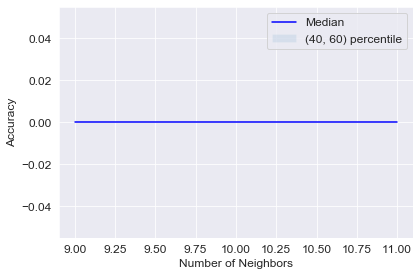

In [74]:
# Number of neighbours
neighs = range(9, 12)

# Store the scores
scores = np.zeros((len(neighs), 3))

# Iterate to find the best model
'''
for idx, neigh in enumerate(neighs):
    print('Neighbours: ', neigh, ' ', str(datetime.now()))
    model = KNeighborsClassifier(n_neighbors = neigh)
    scores[idx, : ] = cross_validate(model, n_splits = 10)
'''    

# Plot the results
plt.plot(neighs, scores[ : , 1], 'b')
plt.fill_between(neighs, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

K = 11 gives the best results 

In [75]:
KNN_model = KNeighborsClassifier(n_neighbors = 11).fit(X, y)

## Decision Tree

Depth:  6   2019-12-21 15:26:13.035496
Depth:  7   2019-12-21 15:26:22.513519
Depth:  8   2019-12-21 15:26:31.834613
Depth:  9   2019-12-21 15:26:42.316461
Depth:  10   2019-12-21 15:26:52.648684
Depth:  11   2019-12-21 15:27:05.353961
Depth:  12   2019-12-21 15:27:19.492390
Depth:  13   2019-12-21 15:27:31.583437
Depth:  14   2019-12-21 15:27:51.593063


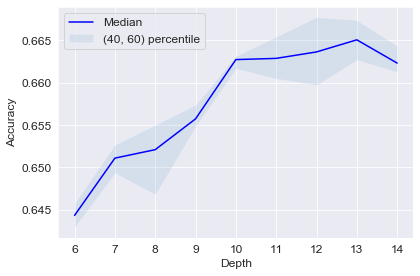

In [76]:
# Decision Tree
from datetime import datetime
from sklearn.tree import DecisionTreeClassifier

# Depth of the Secision Trees
depths = range(6, 15)

# Store the scores
scores = np.zeros((len(depths), 3))

# Iterate to find the best model
for idx, depth in enumerate(depths):
    print('Depth: ', depth, ' ', str(datetime.now()))
    model = DecisionTreeClassifier(criterion = "entropy", max_depth = depth)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

# Plot the results
plt.plot(depths, scores[ : , 1], 'b')
plt.fill_between(depths, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Depth')
plt.tight_layout()
plt.show()

Depth = 13 gives the best results

In [78]:
Tree_model = DecisionTreeClassifier(criterion = "entropy", max_depth = 13).fit(X, y)

## Logistic Regression

C:  0.01   2019-12-21 15:29:33.496348
C:  0.03162277660168379   2019-12-21 15:29:43.540833
C:  0.1   2019-12-21 15:29:51.914844
C:  0.31622776601683794   2019-12-21 15:30:00.740675
C:  1.0   2019-12-21 15:30:09.183808
C:  3.1622776601683795   2019-12-21 15:30:17.493320


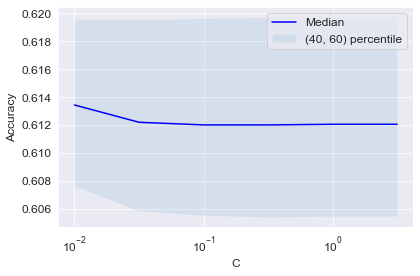

In [79]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression

C = np.logspace(-2.0, 0.5, num = 6, endpoint = True)

scores = np.zeros((len(C), 3))

for idx, c in enumerate(C):
    print('C: ', c, ' ', str(datetime.now()))
    model = LogisticRegression(C = c, solver = 'liblinear')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(C, scores[ : , 1], 'b')
plt.xscale('log')
plt.fill_between(C, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

In [80]:
LR_model = LogisticRegression(C = 0.01, solver = 'liblinear').fit(X, y)

## Naive Bayes

Alpha:  0.1   2019-12-21 15:30:28.385595
Alpha:  0.2   2019-12-21 15:30:34.263942
Alpha:  0.30000000000000004   2019-12-21 15:30:39.561374
Alpha:  0.4   2019-12-21 15:30:45.194357
Alpha:  0.5   2019-12-21 15:30:50.915514
Alpha:  0.6   2019-12-21 15:30:56.429518
Alpha:  0.7000000000000001   2019-12-21 15:31:01.884168
Alpha:  0.8   2019-12-21 15:31:07.052586
Alpha:  0.9   2019-12-21 15:31:12.689072
Alpha:  1.0   2019-12-21 15:31:18.421069


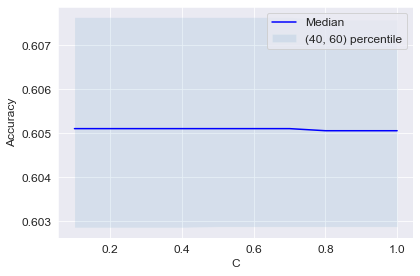

In [81]:
# Naive Bayes

alpha = np.linspace(0.1, 1, num=10)

scores = np.zeros((len(alpha), 3))

for idx, a in enumerate(alpha):
    print('Alpha: ', a, ' ', str(datetime.now()))
    model = BernoulliNB(alpha=a)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(alpha, scores[ : , 1], 'b')
plt.fill_between(alpha, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

In [82]:
NB_model = BernoulliNB(alpha=1.0).fit(X, y)

## Decision Forest using a Random Forest

Estimator:  18   2019-12-21 15:31:24.926998
Estimator:  19   2019-12-21 15:32:08.128984
Estimator:  20   2019-12-21 15:32:47.265464
Estimator:  21   2019-12-21 15:33:31.110318


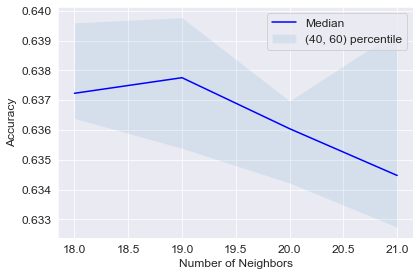

In [83]:


est = range(18, 22)
scores = np.zeros((len(est), 3))
for idx, a in enumerate(est):
    print('Estimator: ', a, ' ', str(datetime.now()))
    model = RandomForestClassifier(n_estimators = a, max_features = 'sqrt')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(est, scores[ : , 1], 'b')
plt.fill_between(est, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

In [84]:
Forest_model = RandomForestClassifier(n_estimators = 20, max_features = 'sqrt').fit(X, y)

## Determine the best Model

In [85]:
# Function to iterate over each of the models to get their scores
def get_scores(model):

    # predict
    yhat = model.predict(X)
    
    jaccard = metrics.jaccard_similarity_score(y, yhat)
    f1 = metrics.f1_score(y, yhat, pos_label = 'THEFT')
    logloss = metrics.log_loss(y == 'THEFT', yhat == 'THEFT')
        
    return {'Jaccard' : jaccard, 'F1-Score' : f1, 'LogLoss' : logloss}

# Empty Results List    
results = []

# The Models
models = [[KNN_model, 'KNN'], 
          [Tree_model, 'Decision Tree'], 
          [NB_model, 'Bernoulli Naive Bayes'], 
          [LR_model, 'Logistic Regression'],
          [Forest_model, 'Random Forest']]

# Iterate over each of the models
for model, algorithm in models:
    
    scores = get_scores(model)
    scores['Algorithm'] = algorithm
    results.append(scores)

# Format the results and display them.
results = pd.DataFrame(results)
results.set_index('Algorithm', inplace = True)

results

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:635: DeprecationWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  'and multiclass classification tasks.', DeprecationWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:635: DeprecationWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  'and multiclass classification tasks.', DeprecationWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:635: DeprecationWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior 

,Jaccard,F1-Score,LogLoss
Algorithm,,,
KNN,0.687952,0.717779,10.777894
Decision Tree,0.701947,0.715224,10.294483
Bernoulli Naive Bayes,0.611501,0.659229,13.418452
Logistic Regression,0.621431,0.683302,13.075499
Random Forest,0.994830,0.995317,0.178557


In [86]:
results.to_pickle('./Pickles/results.pkl')

# Best Model

Ramdom Forest is the best model scoring highest in all measurements, F1-Score, Jaccard and Log Loss. Let's now create a new model. The August crime data will become the unseen test data for the final model.

In [87]:
# Import the Pickle of the Crimes DataFrame
df_crimes = pd.read_pickle('./Pickles/crimes.pkl')
df_crimes.drop('index', inplace=True, axis=1)

### Recreate the Features DataFrame

Recreate the Features DataFrame but this time use all of the data.

In [88]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features = df_crimes[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features = df_features.join(pd.get_dummies(df_crimes.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(df_crimes.day_name))
df_features = df_features.join(pd.get_dummies(df_crimes.month_name))

# Finally add the ward & crimes column, copied from the original Primary Description column
df_features['ward'] = df_crimes[['ward']]
df_features['crimes'] = df_crimes[['primary_type']]

# Create a list of the 2 most commonly occuring crimes
top_two_crimes = df_features[['crimes', 'ward']].groupby(
    ['crimes']).count().sort_values('ward', ascending=False)[:2].axes[0].tolist()

# Create a smaller DataFrame of only the top two crimes
df_features = df_features[df_features['crimes'].isin(top_two_crimes)].copy()

In [89]:
# Looking at the head of the features dataframe we can see the encoded labels
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
0,41.710046,-87.639273,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,34.0,THEFT
1,41.893150,-87.747057,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,37.0,THEFT
2,41.906276,-87.670012,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1.0,THEFT
3,41.810768,-87.684508,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,15.0,THEFT
8,41.866148,-87.726825,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,24.0,THEFT


In [90]:
df_features.dtypes

latitude     float64
longitude    float64
hour_0         uint8
hour_1         uint8
hour_2         uint8
hour_3         uint8
hour_4         uint8
hour_5         uint8
hour_6         uint8
hour_7         uint8
hour_8         uint8
hour_9         uint8
hour_10        uint8
hour_11        uint8
hour_12        uint8
hour_13        uint8
hour_14        uint8
hour_15        uint8
hour_16        uint8
hour_17        uint8
hour_18        uint8
hour_19        uint8
hour_20        uint8
hour_21        uint8
hour_22        uint8
hour_23        uint8
Friday         uint8
Monday         uint8
Saturday       uint8
Sunday         uint8
Thursday       uint8
Tuesday        uint8
Wednesday      uint8
April          uint8
August         uint8
December       uint8
February       uint8
January        uint8
July           uint8
June           uint8
March          uint8
May            uint8
November       uint8
October        uint8
September      uint8
ward         float64
crimes        object
dtype: object

### Create the Train Datasets

In [91]:
X_Train = df_features[df_features.August == 0].copy()
X_Train.drop('crimes', axis=1, inplace=True)

# Normalise df_features

X_Train = preprocessing.StandardScaler().fit(X_Train).transform(X_Train)

y_Train = df_features.crimes[df_features.August == 0].values

### Create the Test Datasets

In [92]:
X_Test = df_features[df_features.August == 1].copy()
X_Test.drop('crimes', axis=1, inplace=True)

# Normalise df_features
X_Test = preprocessing.StandardScaler().fit(X_Test).transform(X_Test)

y_Test = df_features.crimes[df_features.August == 1].values

### Recreate the Random Forest Model

In [93]:
Forest_model_final = RandomForestClassifier(n_estimators = 20, max_features = 'sqrt').fit(X_Train, y_Train)

### Predict the Final Performance of the Model

In [94]:
# Predict yhat using X_Test
yhat = Forest_model_final.predict(X_Test)
    
# Measure the Jaccard Score of the final Model
jaccard_final = metrics.jaccard_similarity_score(y_Test, yhat)
print('Jaccard Score', jaccard_final)
    
f1 = metrics.f1_score(y_Test, yhat, average=None)
print('F1-Score of each class', f1)

Jaccard Score 0.6392685455745122
F1-Score of each class [0.60672079 0.66684078]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:635: DeprecationWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  'and multiclass classification tasks.', DeprecationWarning)


### What are the important Features

In [95]:
importances = Forest_model_final.feature_importances_

Feature ranking:
1. feature 0 (0.272658)
2. feature 1 (0.254064)
3. feature 45 (0.116774)
4. feature 38 (0.013366)
5. feature 26 (0.013309)
6. feature 39 (0.013128)
7. feature 30 (0.012905)
8. feature 41 (0.012600)
9. feature 44 (0.012535)
10. feature 27 (0.012527)
11. feature 31 (0.012139)
12. feature 33 (0.011876)
13. feature 42 (0.011713)
14. feature 37 (0.011625)
15. feature 36 (0.011514)
16. feature 43 (0.011416)
17. feature 32 (0.011414)
18. feature 40 (0.010748)
19. feature 28 (0.010442)
20. feature 21 (0.008153)
21. feature 18 (0.007771)
22. feature 29 (0.007732)
23. feature 17 (0.007607)
24. feature 20 (0.007482)
25. feature 22 (0.007390)
26. feature 19 (0.007089)
27. feature 35 (0.006865)
28. feature 11 (0.006850)
29. feature 13 (0.006782)
30. feature 23 (0.006656)
31. feature 24 (0.006504)
32. feature 16 (0.006488)
33. feature 12 (0.006397)
34. feature 2 (0.006238)
35. feature 10 (0.006032)
36. feature 14 (0.005797)
37. feature 15 (0.005725)
38. feature 3 (0.005677)
39. feat

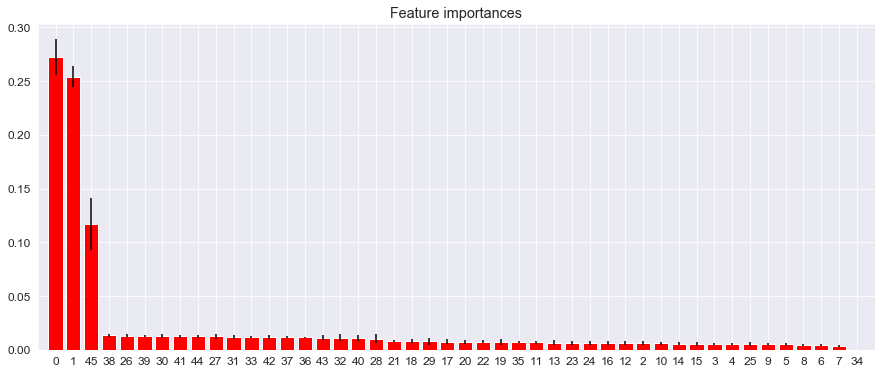

In [96]:
std = np.std([tree.feature_importances_ for tree in Forest_model_final.estimators_],
             axis=0)

indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X_Train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure(figsize=(15, 6))
plt.title("Feature importances")
plt.bar(range(X_Train.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X_Train.shape[1]), indices)
plt.xlim([-1, X_Train.shape[1]])
plt.show()

This shows that the most predictive models are:

1. Latitude
1. Longitude
1. Ward

The other features, particulraly the hour the crime took place, are less predictive.

In [97]:
# Predict yhat using X_Test
yhat_dt = Forest_model_final.predict(X_Test)
    
# Measure the Jaccard Score of the final Model
jaccard_final = metrics.jaccard_similarity_score(y_Test, yhat_dt)
print('Jaccard Score', jaccard_final)
    
f1 = metrics.f1_score(y_Test, yhat_dt, average=None)
print('F1-Score of each class', f1)

Jaccard Score 0.6392685455745122
F1-Score of each class [0.60672079 0.66684078]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:635: DeprecationWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  'and multiclass classification tasks.', DeprecationWarning)


# Further Visualisation

Because it was not possible, because of the categorical nature of the data, to do more details inferential statistical analysis of the data further exploratory visualisation was undertaken. It shouldbe noted, however, that this visualisation would actually become part of the final presentation to the traveller. It would be important for the traveller to see the crime, venue and restaurant data presented in this manner.


In [98]:
# Import Pandas
import pandas as pd

# Import Numpy
import numpy as np

# Use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 14}
mpl.rc('font', **font)

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

from folium import plugins
from folium.plugins import HeatMap


from sklearn.neighbors import DistanceMetric



In [99]:
# Very useful function to calculate the great circle distance between two points
# Found here and adapted:
# https://stackoverflow.com/questions/40452759/pandas-latitude-longitude-to-distance-between-successive-rows

def haversine(row):
    dist = DistanceMetric.get_metric('haversine')
   
    lat1, lon1, lat2, lon2 = map(np.radians, [row['latitude'], 
                                              row['longitude'], 
                                              row['ven_lat'], 
                                              row['ven_lon']])

    X = [[lat1, lon1],
         [lat2, lon2]]
    
    kms = 6367
    
    return kms * dist.pairwise(X)[0][1]

In [100]:
# Import the Pickle of the Crimes DataFrame
df_crimes = pd.read_pickle('./Pickles/crimes.pkl')
df_crimes.drop('index', inplace=True, axis=1)

# Import the Pickle of the Top Venues DataFrame
df_top_venues = pd.read_pickle('./Pickles/top_venues.pkl')
df_top_venues['name'] = df_top_venues['name'].str.replace("'",'')
df_top_venues['name'] = df_top_venues['name'].str.replace("&",' and ')
df_top_venues['name'] = df_top_venues['name'].str.replace(",",'')

# Import the Pickle of the Restaurants DataFrame
df_rest = pd.read_pickle('./Pickles/restaurants.pkl')

# To display the Name correctly need to remove ' and & symbols
df_rest['name'] = df_rest['name'].str.replace("'",'')
df_rest['name'] = df_rest['name'].str.replace("&",' and ')
df_rest['name'] = df_rest['name'].str.replace(",",'')

## Top venues with more than 5 Restaurants nearby

In [101]:
# The Top Venues / Sites from the restaurant dataframe
top_venues_list = df_rest.venue_name.unique().tolist()

In [102]:
# Filter the top venues dataframe using the top venues list
df_top_venues = df_top_venues[df_top_venues['name'].isin(top_venues_list)]

# Take just the top 5 venues, sorted by score, to reduce to show the concept
df_top5_venues = df_top_venues.sort_values('score', ascending=False)[:8]

# Create a list of the top 5 venues names
top5_venues_list = df_top5_venues.name.tolist()

# Finally filter the Restaurants data frame to include only the top 4 venues
df_rest = df_rest[df_rest['venue_name'].isin(top5_venues_list)]

df_rest.reset_index(inplace=True)

In [103]:
# Create a list of the 2 most commonly occuring crimes
top_two_crimes = df_crimes[['primary_type', 'case_number']].groupby(
    ['primary_type']).count().sort_values('case_number', ascending=False)[:2].axes[0].tolist()

# Create a smaller DataFrame of only the top two crimes
df_crimes = df_crimes[df_crimes['primary_type'].isin(top_two_crimes)]
df_crimes.reset_index(inplace=True)
df_crimes.drop('index', inplace=True, axis=1)

In [104]:
df_dist = pd.DataFrame()

for name, lat, lon in zip(df_top5_venues.name,
                          df_top5_venues.latitude,
                          df_top5_venues.longitude):
    print('Processing: ', name)
    df_temp = df_crimes.copy()
    df_temp['ven_lat'] = lat
    df_temp['ven_lon'] = lon
    df_dist[name] = df_temp.apply(haversine, axis=1)

Processing:  Millennium Park
Processing:  The Art Institute of Chicago
Processing:  Grant Park
Processing:  Chicago Riverwalk
Processing:  Symphony Center (Chicago Symphony Orchestra)


In [105]:
df_dist.head()

,Millennium Park,The Art Institute of Chicago,Grant Park,Chicago Riverwalk,Symphony Center (Chicago Symphony Orchestra)
0,19.274402,18.887747,18.585300,19.720469,18.844465
1,10.253295,10.327641,10.730855,9.935124,10.240885
2,4.604952,4.852943,5.336704,4.121448,4.802520
3,9.478476,9.164353,9.095797,9.735555,9.082122
4,8.726578,8.675437,8.976500,8.569785,8.577143


In [106]:
df_dist.to_pickle('./Pickles/distances.pkl')

# Display each of the Top 5 Venues

In this section a preview of the type of data that will be displayed to a user of the proposed solution is shown.

For each of the Top 5 Venues:
1. All crimes within 750 meters of the venue are added to a dataframe
1. All restaurants associated with the venue are added to a dataframe
1. A folium Map is created centered on the venue
1. A heatmap of the crimes in the area are overlayed
1. the venue is marked on the map
1. The top 10 scored restaurants are marked on the map

It is possible to fully automate this through full iteration but in order to clearly show each of the 5 maps each is generated manually (to a limit)

## Venue 01

In [107]:
# Get the name of the Top Venue for this iteration
top_venue = top5_venues_list[0]

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

In [108]:
# Create a dataframe of the restaurants associated with the venue
df_rest_venue = df_rest[df_rest.venue_name == top_venue].copy()

# Sort the restaurants so we can pick the top 10
df_rest_venue.sort_values('score', ascending=False, inplace=True)

In [109]:
# Define Venue geolocation coordinates
chicago_latitude = df_top5_venues.latitude[df_top5_venues.name == top_venue].values[0]  
chicago_longitude = df_top5_venues.longitude[df_top5_venues.name == top_venue].values[0]

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=16) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Add the Top 10 Restaurants to the map
for row in df_rest_venue[:10].itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  popup=popup,
                  icon=folium.Icon(color='red', icon='thumbs-up')
                 ).add_to(chicago_heatmat)


# Display the map
chicago_heatmat

## Venue 02

In [110]:
# Get the name of the Top Venue for this iteration
top_venue = top5_venues_list[1]

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

In [111]:
# Create a dataframe of the restaurants associated with the venue
df_rest_venue = df_rest[df_rest.venue_name == top_venue].copy()

# Sort the restaurants so we can pick the top 5
df_rest_venue.sort_values('score', ascending=False, inplace=True)

In [112]:
# Define Venue geolocation coordinates
chicago_latitude = df_top5_venues.latitude[df_top5_venues.name == top_venue].values[0]  
chicago_longitude = df_top5_venues.longitude[df_top5_venues.name == top_venue].values[0]

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=16) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Top 10 Restaurants to the map
for row in df_rest_venue[:10].itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  popup=popup,
                  icon=folium.Icon(color='red', icon='thumbs-up')
                 ).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

## Venue 03

In [113]:
# Get the name of the Top Venue for this iteration
top_venue = top5_venues_list[2]

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

In [114]:
# Create a dataframe of the restaurants associated with the venue
df_rest_venue = df_rest[df_rest.venue_name == top_venue].copy()

# Sort the restaurants so we can pick the top 5
df_rest_venue.sort_values('score', ascending=False, inplace=True)

In [115]:
# Define Venue geolocation coordinates
chicago_latitude = df_top5_venues.latitude[df_top5_venues.name == top_venue].values[0]  
chicago_longitude = df_top5_venues.longitude[df_top5_venues.name == top_venue].values[0]

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=16) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Top 10 Restaurants to the map
for row in df_rest_venue[:10].itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  popup=popup,
                  icon=folium.Icon(color='red', icon='thumbs-up')
                 ).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

## Venue 04

In [116]:
# Get the name of the Top Venue for this iteration
top_venue = top5_venues_list[3]

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

In [117]:
# Create a dataframe of the restaurants associated with the venue
df_rest_venue = df_rest[df_rest.venue_name == top_venue].copy()

# Sort the restaurants so we can pick the top 5
df_rest_venue.sort_values('score', ascending=False, inplace=True)

In [118]:
# Define Venue geolocation coordinates
chicago_latitude = df_top5_venues.latitude[df_top5_venues.name == top_venue].values[0]  
chicago_longitude = df_top5_venues.longitude[df_top5_venues.name == top_venue].values[0]

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=16) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Add the Top 10 Restaurants to the map
for row in df_rest_venue[:10].itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  popup=popup,
                  icon=folium.Icon(color='red', icon='thumbs-up')
                 ).add_to(chicago_heatmat)


# Display the map
chicago_heatmat

## Venue 05

In [119]:
# Get the name of the Top Venue for this iteration
top_venue = top5_venues_list[4]

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

In [120]:
# Create a dataframe of the restaurants associated with the venue
df_rest_venue = df_rest[df_rest.venue_name == top_venue].copy()

# Sort the restaurants so we can pick the top 5
df_rest_venue.sort_values('score', ascending=False, inplace=True)

In [121]:
# Define Venue geolocation coordinates
chicago_latitude = df_top5_venues.latitude[df_top5_venues.name == top_venue].values[0]  
chicago_longitude = df_top5_venues.longitude[df_top5_venues.name == top_venue].values[0]

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=16) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Add the Top 10 Restaurants to the map
for row in df_rest_venue[:10].itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  popup=popup,
                  icon=folium.Icon(color='red', icon='thumbs-up')
                 ).add_to(chicago_heatmat)


# Display the map
chicago_heatmat

# Crime Prediction

The nature of the dataset, particularly the number of different crimes and the unbalanced nature of the dataset, makes it difficult to predict what crime will predict and when. We can, however, repurpose the Crimes DataFrame by spliting the dataset into two distinct sets. 

## Import the Required Libraries

Import the librarie that are required to execute this Notebook.

In [122]:
# Import Pandas
import pandas as pd

# Import Numpy
import numpy as np

# All the SciKit Learn Libraries Required
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import KFold, cross_val_score

from random import randint

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

from folium import plugins
from folium.plugins import HeatMap

from sklearn.neighbors import DistanceMetric

# Very useful function to calculate the great circle distance between two points
# Found here and adapted:
# https://stackoverflow.com/questions/40452759/pandas-latitude-longitude-to-distance-between-successive-rows

def haversine(row):
    dist = DistanceMetric.get_metric('haversine')
   
    lat1, lon1, lat2, lon2 = map(np.radians, [row['latitude'], 
                                              row['longitude'], 
                                              row['ven_lat'], 
                                              row['ven_lon']])

    X = [[lat1, lon1],
         [lat2, lon2]]
    
    kms = 6367
    
    return kms * dist.pairwise(X)[0][1]

## Import the DataFrames

Import the saved dataframes and create the Features DataFrame

In [123]:
# Import the Pickle of the Crimes DataFrame
df_crimes = pd.read_pickle('./Pickles/crimes.pkl')
df_crimes.drop('index', inplace=True, axis=1)

# Import the Pickle of the Top Venues DataFrame
df_topvnues = pd.read_pickle('./Pickles/top_venues.pkl')

# Import the Pickle of the Restaurants DataFrame
df_rest = pd.read_pickle('./Pickles/restaurants.pkl')

# Start by copying the Latitude and Longitude to the new DataFrame
df_features = df_crimes[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features = df_features.join(pd.get_dummies(df_crimes.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(df_crimes.day_name))
df_features = df_features.join(pd.get_dummies(df_crimes.month_name))

# Finally add the ward column, copied from the original Primary Description column
df_features['ward'] = df_crimes[['ward']]
df_features['crimes'] = df_crimes[['primary_type']]

### Fake Crime Data

Next we'll generate the fake crime data. The crimes will be equally divided between a crimes happened `0` and no crime happened `1`. The Random Forest model will be trainined again on the data from January 2019 to October 2019 and tested against November 2019 to predict the acccuracy of the model.

A new test dataset will then be created for each location in the Top Venues DataFrame and for each Restaurant associated with each of the top Venues. A random visit Date, in November 2019, and time will be associated with each row and then a prediction will be made whether a crime would be committed at each location and date or not.

In [124]:
# Assign Random 
df_features['random_crimes'] = np.random.randint(0, 2, df_features.shape[0])

In [125]:
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes,random_crimes
0,41.710046,-87.639273,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,34.0,THEFT,0
1,41.893150,-87.747057,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,37.0,THEFT,0
2,41.906276,-87.670012,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1.0,THEFT,1
3,41.810768,-87.684508,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,15.0,THEFT,0
4,41.764136,-87.681903,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,18.0,MOTOR VEHICLE THEFT,1


In [126]:
feature_cols = df_features.columns.tolist()

### Create the Test Datasets

In [127]:
# Create the Train Dataset
X_Train = df_features.copy()
X_Train.drop('crimes', axis=1, inplace=True)
X_Train.drop('random_crimes', axis=1, inplace=True)
X_Train.drop('ward', axis=1, inplace=True)

# Normalise df_features
X_Train = preprocessing.StandardScaler().fit(X_Train).transform(X_Train)

y_Train = df_features.random_crimes.values

### Recreate the Random Forest Model

In [128]:
Forest_model_final = RandomForestClassifier(n_estimators = 20, max_features = 'sqrt').fit(X_Train, y_Train)

### Build the DataFrame of Potential Venue visits

In [129]:
# Create temporary dataframes of just latitude and longitude and name
#    from the Top Venues and Restaurant DataFrames
df_top = df_topvnues[['name', 'latitude', 'longitude']]
df_res = df_rest[['name', 'latitude', 'longitude']]

#Join the two dataframes
df_final = pd.concat([df_top, df_res])

# Drop duplicate entries
df_final.drop_duplicates(keep=False, inplace=True)
df_final.shape

(80, 3)

In [130]:
# Add a randon Date / Time to visit each locatio

# Year will always be 2019
year = 2019

# Empty list to hold the dates
dates = []

# Generate a random date for each entry in the dataframe
for i in range(0, df_final.shape[0]):
    month = randint(1, 12)
    day = randint(1, 28)
    hour = randint(0, 23)
    minute = randint(0, 59)
    date = '{:02d}-{:02d}-{:02d} {:02d}:{:02d}:00'.format(month,
                                      day,
                                      year,
                                      hour,
                                      minute)
    dates.append(date)

In [131]:
# We now have a date for each
se = pd.Series(dates)

# Then add the values to the DataFrame:
df_final['date'] = se.values

# Convert the date to a proper DateTime Object
df_final['date'] =  pd.to_datetime(df_final['date'], format='%m-%d-%Y %H:%M:%S')

In [132]:
df_final.head()

,name,latitude,longitude,date
0,Millennium Park,41.883112,-87.623851,2019-06-11 00:26:00
1,The Art Institute of Chicago,41.879610,-87.623552,2019-08-21 21:21:00
2,Grant Park,41.876626,-87.619263,2019-04-14 01:23:00
3,Chicago Riverwalk,41.887280,-87.627217,2019-11-09 06:00:00
4,Symphony Center (Chicago Symphony Orchestra),41.879275,-87.624680,2019-12-04 08:28:00


In [133]:
# Add new columns to the dataframe to allow hourly, daily & monthly analysis
df_final['hour'] = df_final['date'].dt.hour
df_final['day_name'] = df_final['date'].dt.day_name()
df_final['day'] = df_final['date'].dt.dayofweek
df_final['month_name'] = df_final['date'].dt.month_name()
df_final['month'] = df_final['date'].dt.month
df_final['year'] = df_final['date'].dt.year
df_final['year_month'] = df_final['date'].dt.to_period('M')

In [134]:
df_final.reset_index(inplace=True)
df_final.drop('index', inplace=True, axis=1)
df_final.head()

,name,latitude,longitude,date,hour,day_name,day,month_name,month,year,year_month
0,Millennium Park,41.883112,-87.623851,2019-06-11 00:26:00,0,Tuesday,1,June,6,2019,2019-06
1,The Art Institute of Chicago,41.879610,-87.623552,2019-08-21 21:21:00,21,Wednesday,2,August,8,2019,2019-08
2,Grant Park,41.876626,-87.619263,2019-04-14 01:23:00,1,Sunday,6,April,4,2019,2019-04
3,Chicago Riverwalk,41.887280,-87.627217,2019-11-09 06:00:00,6,Saturday,5,November,11,2019,2019-11
4,Symphony Center (Chicago Symphony Orchestra),41.879275,-87.624680,2019-12-04 08:28:00,8,Wednesday,2,December,12,2019,2019-12


# Data Preparation for Modelling

Before we start modelling we need to prepare the data frame to include only mumerical data and by removing unneeded columns.

Rather than removing colums a new `df_features` DataFrame will be created with just the required columns. This `df_features` DataFrame will then be processed to remove Categorical Data Types and replace them with One Hot encoding. Finally the Dependant Variables will be Normalised and Principal Component Analysis will be used to reduce the dimensionality of the DataFrame.

In [135]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features_final = df_final[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features_final = df_features_final.join(pd.get_dummies(df_final.hour, prefix='hour'))
df_features_final = df_features_final.join(pd.get_dummies(df_final.day_name))
df_features_final = df_features_final.join(pd.get_dummies(df_final.month_name))

In [136]:
df_features_final.shape

(80, 45)

# Make predictions

In [137]:
# Predict whether crime will happen a each location in the dataframe
yhat = Forest_model_final.predict(df_features_final)

In [138]:
# Display all the predictions - 0 for possible criminal location and 1 for safe
yhat

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

## Predictions Analysis

In total 42 location were predicted as potentially safe locations to visit (19%) and 180 were classified as potentially susceptible to crime (81%).

In [139]:
# Add the predictions back to the datafame
df_final['prediction'] = yhat.tolist()

In [140]:
df_final.head(20)

,name,latitude,longitude,date,hour,day_name,day,month_name,month,year,year_month,prediction
0,Millennium Park,41.883112,-87.623851,2019-06-11 00:26:00,0,Tuesday,1,June,6,2019,2019-06,0
1,The Art Institute of Chicago,41.879610,-87.623552,2019-08-21 21:21:00,21,Wednesday,2,August,8,2019,2019-08,0
2,Grant Park,41.876626,-87.619263,2019-04-14 01:23:00,1,Sunday,6,April,4,2019,2019-04,0
3,Chicago Riverwalk,41.887280,-87.627217,2019-11-09 06:00:00,6,Saturday,5,November,11,2019,2019-11,0
4,Symphony Center (Chicago Symphony Orchestra),41.879275,-87.624680,2019-12-04 08:28:00,8,Wednesday,2,December,12,2019,2019-12,0
5,Garfield Park Conservatory,41.886259,-87.717177,2019-12-11 09:46:00,9,Wednesday,2,December,12,2019,2019-12,0
6,The Chicago Theatre,41.885539,-87.627151,2019-01-19 05:45:00,5,Saturday,5,January,1,2019,2019-01,0
7,Binny's Beverage Depot,41.913048,-87.655320,2019-06-16 23:18:00,23,Sunday,6,June,6,2019,2019-06,0
8,Chicago Lakefront Trail,41.967053,-87.646909,2019-10-25 00:29:00,0,Friday,4,October,10,2019,2019-10,0
9,Thalia Hall,41.857832,-87.657292,2019-06-07 14:00:00,14,Friday,4,June,6,2019,2019-06,0


## Visualisation of Predictions

Of the top 20 venues 17 were identified as potentially dangerous to visit and 3 was deems safe. As there is no data to compare the predictions against the best way we will visualise the data again.

We will look at the following 5 venues:
1. `Millennium Park     41.882699	-87.623644`
1. `Chicago Riverwalk   41.887280	-87.627217`
1. `The Chicago Theatre 41.885539	-87.627151`
1. `Weber's Bakery      41.791695	-87.798656`
1. `Chicago Lakefront   41.866562	-87.608781`


The Distance Dataframe is recreated again but this time all crimes are included.

In [141]:
top10_venues_name = ['Millennium Park', 'Chicago Riverwalk', 'The Chicago Theatre', 'Weber\'s Bakery', 'Chicago Lakefront']
top10_venues_latitude = [41.882699, 41.887280, 41.885539, 41.791695, 41.866562]
top10_venues_longitude = [-87.623644, -87.627217,-87.627151, -87.798656, -87.608781]

df_dist = pd.DataFrame()

for name, lat, lon in zip(top10_venues_name,
                          top10_venues_latitude,
                          top10_venues_longitude):
    print('Processing: ', name)
    df_temp = df_crimes.copy()
    df_temp['ven_lat'] = lat
    df_temp['ven_lon'] = lon
    df_dist[name] = df_temp.apply(haversine, axis=1)

Processing:  Millennium Park
Processing:  Chicago Riverwalk
Processing:  The Chicago Theatre
Processing:  Weber's Bakery
Processing:  Chicago Lakefront


### Millennium Park

In [142]:
# Get the name of the Top Venue for this iteration
top_venue = 'Millennium Park'

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

# Define Venue geolocation coordinates
chicago_latitude = 41.882699  
chicago_longitude = -87.623644

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=17) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

### Chicago Riverwalk

In [143]:
# Get the name of the Top Venue for this iteration
top_venue = 'Chicago Riverwalk'

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

# Define Venue geolocation coordinates
chicago_latitude = 41.887280
chicago_longitude = -87.627217

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=17) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

### The Chicago Theatre

In [144]:
# Get the name of the Top Venue for this iteration
top_venue = 'The Chicago Theatre'

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

# Define Venue geolocation coordinates
chicago_latitude = 41.885539
chicago_longitude = -87.627151

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=17) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

### Weber's Bakery

In [145]:
# Get the name of the Top Venue for this iteration
top_venue = 'Weber\'s Bakery'

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

# Define Venue geolocation coordinates
chicago_latitude = 41.791695
chicago_longitude = -87.798656

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=17) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

### Chicago Lakefront

In [146]:
# Get the name of the Top Venue for this iteration
top_venue = 'Chicago Lakefront'

# Create a crime dataframe for the venue
df_crimes_venue = df_crimes.copy()
df_crimes_venue['dist'] = df_dist[top_venue]
df_crimes_venue = df_crimes_venue[df_crimes_venue['dist'] <= 0.75]

# Define Venue geolocation coordinates
chicago_latitude = 41.866562
chicago_longitude = -87.608781

# Create the Folium Map
chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=17) 

# List comprehension to make out list of lists of Crime Loatitude and Longitude
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_crimes_venue.iterrows()]

# Plot the crimes on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=20,
        blur=30,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Add the Venue to the Map
folium.Marker(
    location=[chicago_latitude, chicago_longitude],
    popup=top_venue,
    icon=folium.Icon(color='blue', icon='info-sign')
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat